# CHATGPT TWEETS ANALYSIS USING NLP

Develop a sentiment analysis model tailored to ChatGPT-generated tweets to accurately classify the sentiment expressed in the text into positive, negative, or neutral categories. The model should be able to handle the nuances and informal language typical of tweets generated by ChatGPT, considering factors such as slang, sarcasm, and context dependencies. The goal is to provide insights into the overall sentiment of ChatGPT-generated tweets, enabling better understanding and analysis of public opinion, trends, and user interactions." 

In [1]:
import pandas as pd 
import numpy as np 
import re # this is the regular expression library which helps us manipulate text (strings) fairly easily and intuitively
import nltk # this is the Natural Language Tool Kit which contains a lot of functionalities for text analytics
import matplotlib.pyplot as plt
import string # this is used for string manipulations
import matplotlib
import warnings 
warnings.filterwarnings( "ignore")

Now, let us load the data and look at a few other text mining functionalities that Python offers us and then go on to fit a classifier algorithm.

In [2]:
chatgpt_tweets=pd.read_csv('file.csv')

In [3]:
chatgpt_tweets

,Unnamed: 0,tweets,labels
0,0,ChatGPT: Optimizing Language Models for Dialog...,neutral
1,1,"Try talking with ChatGPT, our new AI system wh...",good
2,2,ChatGPT: Optimizing Language Models for Dialog...,neutral
3,3,"THRILLED to share that ChatGPT, our new model ...",good
4,4,"As of 2 minutes ago, @OpenAI released their ne...",bad
...,...,...,...
219289,219289,Other Software Projects Are Now Trying to Repl...,bad
219290,219290,I asked #ChatGPT to write a #NYE Joke for SEOs...,good
219291,219291,chatgpt is being disassembled until it can onl...,bad
219292,219292,2023 predictions by #chatGPT. Nothing really s...,bad


In [4]:
chatgpt_tweets.shape

(219294, 3)

In [5]:
chatgpt_tweets['labels'].unique()

array(['neutral', 'good', 'bad'], dtype=object)

# Basic Exploration in Text Mining

# Number of words
To create a temporary function lambda can be used. These functions do not require a name like a def function, however the output is same as defining a permanent function As these function are temporary, memory comsumption is less in comparison to permanent function. Also there are multiple ways to get a similar output

# total word in tweets

In [6]:
chatgpt_tweets['totalwords'] = [len(x.split()) for x in chatgpt_tweets['tweets']]
chatgpt_tweets[['tweets','totalwords']]

,tweets,totalwords
0,ChatGPT: Optimizing Language Models for Dialog...,8
1,"Try talking with ChatGPT, our new AI system wh...",21
2,ChatGPT: Optimizing Language Models for Dialog...,26
3,"THRILLED to share that ChatGPT, our new model ...",22
4,"As of 2 minutes ago, @OpenAI released their ne...",20
...,...,...
219289,Other Software Projects Are Now Trying to Repl...,10
219290,I asked #ChatGPT to write a #NYE Joke for SEOs...,42
219291,chatgpt is being disassembled until it can onl...,9
219292,2023 predictions by #chatGPT. Nothing really s...,27


# word_count in tweets

In [7]:
chatgpt_tweets['word_count'] = chatgpt_tweets['tweets'].apply(lambda x: len(str(x).split(" ")))
chatgpt_tweets[['tweets','word_count']]

,tweets,word_count
0,ChatGPT: Optimizing Language Models for Dialog...,8
1,"Try talking with ChatGPT, our new AI system wh...",21
2,ChatGPT: Optimizing Language Models for Dialog...,26
3,"THRILLED to share that ChatGPT, our new model ...",22
4,"As of 2 minutes ago, @OpenAI released their ne...",20
...,...,...
219289,Other Software Projects Are Now Trying to Repl...,10
219290,I asked #ChatGPT to write a #NYE Joke for SEOs...,42
219291,chatgpt is being disassembled until it can onl...,9
219292,2023 predictions by #chatGPT. Nothing really s...,27


# Number of Characters- including spaces

In [8]:
chatgpt_tweets['char_count'] = chatgpt_tweets['tweets'].str.len()
chatgpt_tweets[['tweets','char_count']].head()

,tweets,char_count
0,ChatGPT: Optimizing Language Models for Dialog...,80
1,"Try talking with ChatGPT, our new AI system wh...",139
2,ChatGPT: Optimizing Language Models for Dialog...,264
3,"THRILLED to share that ChatGPT, our new model ...",188
4,"As of 2 minutes ago, @OpenAI released their ne...",139


## Characters excluding spaces


In [9]:
len(chatgpt_tweets['tweets'][4].replace(' ',' '))

139

In [10]:
139/20

6.95

# Average Word Length

In [11]:
def avg_word(sentence):
    words = sentence.split() #splitting the words separately from the input taken
    return (sum(len(word) for word in words)/len(words)) # getting the average number of words in the each of the entries

chatgpt_tweets['avg_word'] = chatgpt_tweets['tweets'].apply(lambda x: avg_word(x))
chatgpt_tweets[['tweets','avg_word']].head()

,tweets,avg_word
0,ChatGPT: Optimizing Language Models for Dialog...,9.125000
1,"Try talking with ChatGPT, our new AI system wh...",5.666667
2,ChatGPT: Optimizing Language Models for Dialog...,9.192308
3,"THRILLED to share that ChatGPT, our new model ...",7.590909
4,"As of 2 minutes ago, @OpenAI released their ne...",6.000000


# Number of stop Words

In [12]:
from nltk.corpus import stopwords
stop = stopwords.words('english')

chatgpt_tweets['stopwords'] = chatgpt_tweets['tweets'].apply(lambda x: len([x for x in x.split() if x in stop]))
chatgpt_tweets[['tweets','stopwords']]

,tweets,stopwords
0,ChatGPT: Optimizing Language Models for Dialog...,1
1,"Try talking with ChatGPT, our new AI system wh...",6
2,ChatGPT: Optimizing Language Models for Dialog...,3
3,"THRILLED to share that ChatGPT, our new model ...",8
4,"As of 2 minutes ago, @OpenAI released their ne...",6
...,...,...
219289,Other Software Projects Are Now Trying to Repl...,1
219290,I asked #ChatGPT to write a #NYE Joke for SEOs...,15
219291,chatgpt is being disassembled until it can onl...,6
219292,2023 predictions by #chatGPT. Nothing really s...,10


# Number of special character

In [13]:
chatgpt_tweets['hastags'] = chatgpt_tweets['tweets'].apply(lambda x: len([x for x in x.split() if x.startswith('#')]))
chatgpt_tweets[['tweets','hastags']].head()

,tweets,hastags
0,ChatGPT: Optimizing Language Models for Dialog...,0
1,"Try talking with ChatGPT, our new AI system wh...",0
2,ChatGPT: Optimizing Language Models for Dialog...,4
3,"THRILLED to share that ChatGPT, our new model ...",0
4,"As of 2 minutes ago, @OpenAI released their ne...",0


# Number of numerics

In [14]:
# regular expression requaire 2 input  ,what to find, where to find
chatgpt_tweets['numerics'] = chatgpt_tweets['tweets'].apply(lambda x: len(re.findall('[0-9]',x)))
chatgpt_tweets[['tweets','numerics']].head()

,tweets,numerics
0,ChatGPT: Optimizing Language Models for Dialog...,1
1,"Try talking with ChatGPT, our new AI system wh...",3
2,ChatGPT: Optimizing Language Models for Dialog...,3
3,"THRILLED to share that ChatGPT, our new model ...",3
4,"As of 2 minutes ago, @OpenAI released their ne...",8


# Number of Uppercase Letters

In [15]:
chatgpt_tweets['upper_letter'] = chatgpt_tweets['tweets'].apply(lambda x: len(re.findall('[A-Z]',x)))
chatgpt_tweets[['tweets','upper_letter']].head()

,tweets,upper_letter
0,ChatGPT: Optimizing Language Models for Dialog...,15
1,"Try talking with ChatGPT, our new AI system wh...",11
2,ChatGPT: Optimizing Language Models for Dialog...,43
3,"THRILLED to share that ChatGPT, our new model ...",20
4,"As of 2 minutes ago, @OpenAI released their ne...",16


In [16]:
chatgpt_tweets.head()

,Unnamed: 0,tweets,labels,totalwords,word_count,char_count,avg_word,stopwords,hastags,numerics,upper_letter
0,0,ChatGPT: Optimizing Language Models for Dialog...,neutral,8,8,80,9.125000,1,0,1,15
1,1,"Try talking with ChatGPT, our new AI system wh...",good,21,21,139,5.666667,6,0,3,11
2,2,ChatGPT: Optimizing Language Models for Dialog...,neutral,26,26,264,9.192308,3,4,3,43
3,3,"THRILLED to share that ChatGPT, our new model ...",good,22,22,188,7.590909,8,0,3,20
4,4,"As of 2 minutes ago, @OpenAI released their ne...",bad,20,20,139,6.000000,6,0,8,16


# Basic Pre-Processing

# Lower Case conversion


In [17]:
chatgpt_tweets['tweets'] = chatgpt_tweets['tweets'].apply(lambda x: " ".join(x.lower() for x in x.split()))
chatgpt_tweets['tweets'].head()

0    chatgpt: optimizing language models for dialog...
1    try talking with chatgpt, our new ai system wh...
2    chatgpt: optimizing language models for dialog...
3    thrilled to share that chatgpt, our new model ...
4    as of 2 minutes ago, @openai released their ne...
Name: tweets, dtype: object

# Removal of Punctuation

In [18]:
chatgpt_tweets['tweets'] = chatgpt_tweets['tweets'].str.replace('[^\w\s]','')
#\w: Returns a match where the string contains any word characters (characters from a to Z, digits from 0-9, and the underscore _ character)
#\s: Returns a match where the string contains a white space character.
#[^]: Returns a match for any character EXCEPT what is written after it.
chatgpt_tweets['tweets'].head()

0    chatgpt optimizing language models for dialogu...
1    try talking with chatgpt our new ai system whi...
2    chatgpt optimizing language models for dialogu...
3    thrilled to share that chatgpt our new model o...
4    as of 2 minutes ago openai released their new ...
Name: tweets, dtype: object

# Removal of StopWords

In [19]:
from nltk.corpus import stopwords
stop = stopwords.words('english')
chatgpt_tweets['tweets'] = chatgpt_tweets['tweets'].apply(lambda x: " ".join(x for x in x.split() if x not in stop))
chatgpt_tweets['tweets'].head()

0    chatgpt optimizing language models dialogue ht...
1    try talking chatgpt new ai system optimized di...
2    chatgpt optimizing language models dialogue ht...
3    thrilled share chatgpt new model optimized dia...
4    2 minutes ago openai released new chatgpt nnan...
Name: tweets, dtype: object

# Common Words Removal

In [20]:
freq = pd.Series(' '.join(chatgpt_tweets['tweets']).split()).value_counts()[:10]
freq

chatgpt    208251
ai          48630
openai      19548
like        16086
write       14216
new         13602
asked       12831
google      12388
using       11006
use         10703
dtype: int64

In [21]:
chatgpt_tweets['tweets'] = chatgpt_tweets['tweets'].apply(lambda x: " ".join(x for x in x.split() if x not in freq))
chatgpt_tweets['tweets'].head()

0    optimizing language models dialogue httpstcok9...
1    try talking system optimized dialogue feedback...
2    optimizing language models dialogue httpstcogl...
3    thrilled share model optimized dialog public f...
4    2 minutes ago released nnand right httpstcovyp...
Name: tweets, dtype: object

# Rare Words Removal

In [22]:
freq = pd.Series(' '.join(chatgpt_tweets['tweets']).split()).value_counts()[-10:]
freq

httpstcoj5mf3lucpf    1
nnrn                  1
httpstcoumcahzdbkp    1
ainnbrexit            1
brexitnwe             1
wenoh                 1
cakento               1
chaosnbrexits         1
liningnnand           1
httpstcoqjjuf2z2m0    1
dtype: int64

In [23]:
from nltk.stem import WordNetLemmatizer # lemmetising
from nltk.stem import PorterStemmer 

In [24]:
from nltk.stem import PorterStemmer
st = PorterStemmer()
chatgpt_tweets['tweets'].apply(lambda x: " ".join([st.stem(word) for word in x.split()]))

0            optim languag model dialogu httpstcok9rkrygyyn
1         tri talk system optim dialogu feedback help us...
2         optim languag model dialogu httpstcoglebmokn6w...
3         thrill share model optim dialog public free ac...
4         2 minut ago releas nnand right httpstcovypgpnw...
                                ...                        
219289        softwar project tri replic httpstco6tdsiuokbi
219290    nye joke seo deliv nnwhi seo make resolut eat ...
219291                                  disassembl dissembl
219292    2023 predict noth realli specif trend past yea...
219293                        neat stuff httpstcoqjjuf2z2m0
Name: tweets, Length: 219294, dtype: object

Now to get the sentiments as positive and negative , convert the Avg column . If value is >= 0 then tweet is Positive, else tweet is Negative. This will make a dependent variable as a binary classifier¶ 

# Let's look at distribution of different sentiments

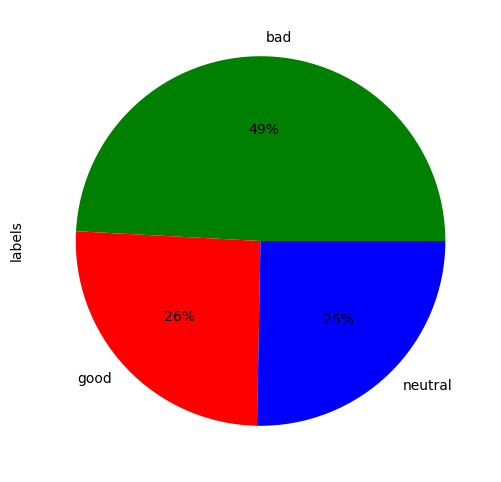

In [49]:
plt.figure(figsize=(8,6))
chatgpt_tweets.labels.value_counts().plot(kind='pie', autopct='%1.0f%%', colors=["green","red","blue"])
plt.show()

In [50]:
chatgpt_tweets.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219294 entries, 0 to 219293
Data columns (total 11 columns):
 #   Column        Non-Null Count   Dtype  
---  ------        --------------   -----  
 0   Unnamed: 0    219294 non-null  int64  
 1   tweets        219294 non-null  object 
 2   labels        219294 non-null  object 
 3   totalwords    219294 non-null  int64  
 4   word_count    219294 non-null  int64  
 5   char_count    219294 non-null  int64  
 6   avg_word      219294 non-null  float64
 7   stopwords     219294 non-null  int64  
 8   hastags       219294 non-null  int64  
 9   numerics      219294 non-null  int64  
 10  upper_letter  219294 non-null  int64  
dtypes: float64(1), int64(8), object(2)
memory usage: 18.4+ MB


In [30]:
chatgpt_tweets.head()

,Unnamed: 0,tweets,labels,totalwords,word_count,char_count,avg_word,stopwords,hastags,numerics,upper_letter
0,0,optimizing language models dialogue httpstcok9...,neutral,8,8,80,9.125000,1,0,1,15
1,1,try talking system optimized dialogue feedback...,good,21,21,139,5.666667,6,0,3,11
2,2,optimizing language models dialogue httpstcogl...,neutral,26,26,264,9.192308,3,4,3,43
3,3,thrilled share model optimized dialog public f...,good,22,22,188,7.590909,8,0,3,20
4,4,2 minutes ago released nnand right httpstcovyp...,bad,20,20,139,6.000000,6,0,8,16


In [51]:
chatgpt_tweets.iloc[:, 1].values

array(['optimizing language models dialogue httpstcok9rkrygyyn',
       'try talking system optimized dialogue feedback help us improve httpstcoshdm57g3kr',
       'optimizing language models dialogue httpstcoglebmokn6w machinelearning datascience artificialintelligencenntrending aiml article identified amp digested via granola machinedriven rss bot ramsey elbasheer httpstcorprmaxup34',
       ..., 'disassembled dissemble',
       '2023 predictions nothing really specific trends past years nshould around topic see 364 days httpstco4zd3kph0dc',
       'neat stuff httpstcoqjjuf2z2m0'], dtype=object)

In [53]:
processed_features = chatgpt_tweets.iloc[:, 1].values
labels = chatgpt_tweets.iloc[:, 2].values

In [54]:
from sklearn.feature_extraction.text import CountVectorizer

In [55]:
chatgpt_tweets.iloc[:, 2]

0         neutral
1            good
2         neutral
3            good
4             bad
           ...   
219289        bad
219290       good
219291        bad
219292        bad
219293    neutral
Name: labels, Length: 219294, dtype: object

In [57]:
processed_features = chatgpt_tweets.iloc[:, 1].values
labels = chatgpt_tweets.iloc[:, 2].values

In [58]:
processed_features

array(['optimizing language models dialogue httpstcok9rkrygyyn',
       'try talking system optimized dialogue feedback help us improve httpstcoshdm57g3kr',
       'optimizing language models dialogue httpstcoglebmokn6w machinelearning datascience artificialintelligencenntrending aiml article identified amp digested via granola machinedriven rss bot ramsey elbasheer httpstcorprmaxup34',
       ..., 'disassembled dissemble',
       '2023 predictions nothing really specific trends past years nshould around topic see 364 days httpstco4zd3kph0dc',
       'neat stuff httpstcoqjjuf2z2m0'], dtype=object)

In [59]:
labels

array(['neutral', 'good', 'neutral', ..., 'bad', 'bad', 'neutral'],
      dtype=object)

# TfidfVectorizer

In [60]:
from sklearn.feature_extraction.text import CountVectorizer

In [61]:
from sklearn.feature_extraction.text import TfidfVectorizer

vectorizer = TfidfVectorizer (max_features=2500, min_df=7, max_df=0.8) #  min_df=7 = it indicates 7 times 
processed_features = vectorizer.fit_transform(processed_features).toarray()

In [62]:
processed_features

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [67]:
vectorizer

TfidfVectorizer(max_df=0.8, max_features=2500, min_df=7)

In [63]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(processed_features, labels, test_size=0.3, random_state=0)

In [70]:
y_train

array(['bad', 'neutral', 'good', ..., 'bad', 'neutral', 'neutral'],
      dtype=object)

In [64]:
# To model the Gaussian Navie Bayes classifier
from sklearn.naive_bayes import GaussianNB
from sklearn import metrics

In [65]:
NB_model = GaussianNB(var_smoothing=1e-15)
NB_model.fit(X_train, y_train)

GaussianNB(var_smoothing=1e-15)

In [71]:
y_train_predict = NB_model.predict(X_train)
model_score = NB_model.score(X_train, y_train)                      ## Accuracy
print(model_score)
print(metrics.confusion_matrix(y_train, y_train_predict))          ## confusion_matrix
print(metrics.classification_report(y_train, y_train_predict))     ## classification_report

0.649587961304192
[[56362 11115  8219]
 [ 3516 28131  7445]
 [ 9250 14245 15222]]
              precision    recall  f1-score   support

         bad       0.82      0.74      0.78     75696
        good       0.53      0.72      0.61     39092
     neutral       0.49      0.39      0.44     38717

    accuracy                           0.65    153505
   macro avg       0.61      0.62      0.61    153505
weighted avg       0.66      0.65      0.65    153505



In [72]:
## Performance Matrix on test data set
y_test_predict = NB_model.predict(X_test)
model_score = NB_model.score(X_test, y_test)                    ## Accuracy
print(model_score)
print(metrics.confusion_matrix(y_test, y_test_predict))         ## confusion_matrix
print(metrics.classification_report(y_test, y_test_predict))    ## classification_report

0.6317621486874706
[[23620  4833  3647]
 [ 1566 11818  3535]
 [ 4147  6498  6125]]
              precision    recall  f1-score   support

         bad       0.81      0.74      0.77     32100
        good       0.51      0.70      0.59     16919
     neutral       0.46      0.37      0.41     16770

    accuracy                           0.63     65789
   macro avg       0.59      0.60      0.59     65789
weighted avg       0.64      0.63      0.63     65789



In [74]:
# Training Data Probability Prediction
pred_prob_train = NB_model.predict_proba(X_train)

# Test Data Probability Prediction
pred_prob_test = NB_model.predict_proba(X_test)

In [75]:
pred_prob_train

array([[1.00000000e+000, 1.70569675e-034, 1.18153783e-087],
       [1.00000000e+000, 0.00000000e+000, 3.04245542e-240],
       [6.22473297e-119, 1.14524387e-061, 1.00000000e+000],
       ...,
       [5.27166266e-010, 0.00000000e+000, 9.99999999e-001],
       [1.48700147e-139, 1.36313803e-217, 1.00000000e+000],
       [1.00000000e+000, 2.70479177e-193, 2.16197043e-140]])

In [88]:
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_train, probs,pos_label='bad')

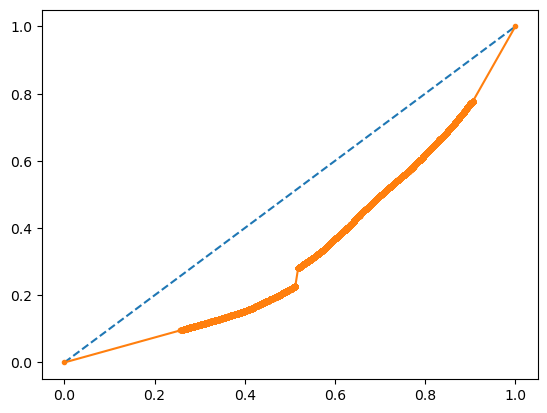

In [89]:
# AUC and ROC for the training data

plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [90]:
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_train, probs,pos_label='good')

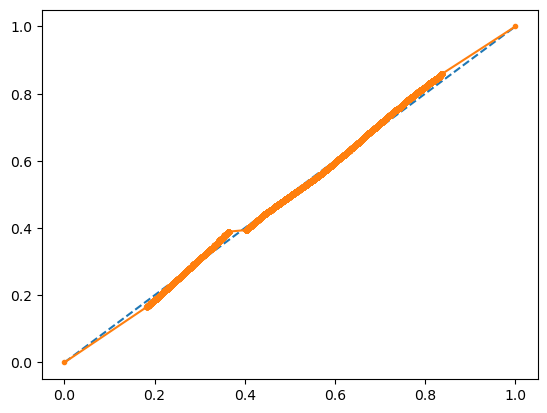

In [91]:
# AUC and ROC for the training data

plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

In [96]:
from sklearn.metrics import roc_curve
fpr, tpr, thresholds = roc_curve(y_train, probs,pos_label='neutral')

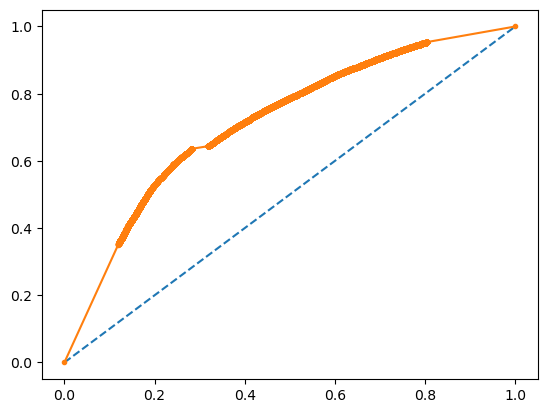

In [97]:
# AUC and ROC for the training data

plt.plot([0, 1], [0, 1], linestyle='--')
# plot the roc curve for the model
plt.plot(fpr, tpr, marker='.')
# show the plot
plt.show()

# Creating a Wordcloud

In [101]:
chatgpt_tweets['tweets'].iloc[30:31]

30    research preview nnit optimized dialogue ready...
Name: tweets, dtype: object

In [102]:

stop_words = list(stopwords.words('english'))
stop_words.extend(["chatgpt", "http","bit","bitly","bit ly", "dear", "im", "i'm", "please"])

In [104]:
#Removing stop words (extended list as above) from the corpus 

corpus = chatgpt_tweets['tweets'].apply(lambda x: ' '.join([z for z in x.split() if z not in stop_words])) 
corpus

0         optimizing language models dialogue httpstcok9...
1         try talking system optimized dialogue feedback...
2         optimizing language models dialogue httpstcogl...
3         thrilled share model optimized dialog public f...
4         2 minutes ago released nnand right httpstcovyp...
                                ...                        
219289    software projects trying replicate httpstco6td...
219290    nye joke seos delivered nnwhy seo make resolut...
219291                               disassembled dissemble
219292    2023 predictions nothing really specific trend...
219293                        neat stuff httpstcoqjjuf2z2m0
Name: tweets, Length: 219294, dtype: object

In [105]:
wc_a = ' '.join(corpus)

In [106]:
wc_a

'optimizing language models dialogue httpstcok9rkrygyyn try talking system optimized dialogue feedback help us improve httpstcoshdm57g3kr optimizing language models dialogue httpstcoglebmokn6w machinelearning datascience artificialintelligencenntrending aiml article identified amp digested via granola machinedriven rss bot ramsey elbasheer httpstcorprmaxup34 thrilled share model optimized dialog public free accessible everyone httpstcodyvthecybd httpstcoddhzhqhcbx httpstcol8qtlure71 2 minutes ago released nnand right httpstcovypgpnw988 httpstcocsn5h6h1m1 launched system optimized dialogue httpstcoarx6m0fflenntry httpstcoym1gp5ba64 2 minutes ago released nnand right n nhttpstcokucnwyhq1bnn httpstcokce59xs0yg httpstcocsn5h6h1m1 coming strong refusing help stalk someone agreeing providing someone waldo httpstcocvijerbw38 0penal deployed thing ive helping build last couple months chatbot based gpt 3 really excited share vlnhttpstcozp7hniuxbunhttpstconisjlwhomw research preview newest model

Word Cloud for chatgpt_Tweets (after cleaning)!!


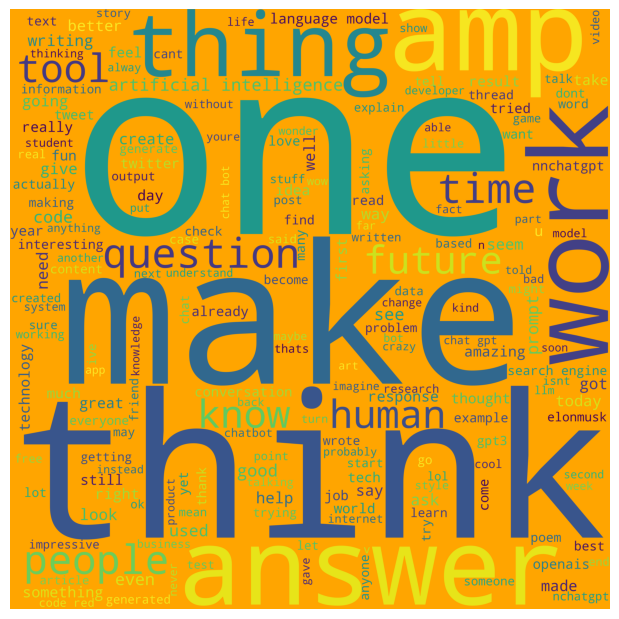

In [110]:
# Word Cloud 
from wordcloud import WordCloud
wordcloud = WordCloud(width = 5000, height = 5000, 
                background_color ='orange', 
                min_font_size = 10, random_state=100).generate(wc_a) 
  
# plot the WordCloud image                        
plt.figure(figsize = (6, 6), facecolor = None) 
plt.imshow(wordcloud) 
plt.axis("off")
plt.xlabel('Word Cloud')
plt.tight_layout(pad = 0) 

print("Word Cloud for chatgpt_Tweets (after cleaning)!!")
plt.show()